# External modules

In [1]:
options(tidyverse.quiet = TRUE)
options(caret.quiet = TRUE)
options(Hmisc.quiet = TRUE)
options(vroom.quiet = TRUE)

In [2]:
library(tidyverse)
library(readr)
library(DescTools)
library(Hmisc)


Attaching package: ‘Hmisc’


The following objects are masked from ‘package:DescTools’:

    %nin%, Label, Mean, Quantile


The following objects are masked from ‘package:dplyr’:

    src, summarize


The following objects are masked from ‘package:base’:

    format.pval, units




# Internal functions

In [4]:
path <- ".."

xfun::in_dir(dir = path, expr = source("./eva_pipeline/src/read_data.R"))
xfun::in_dir(dir = path, expr = source("./eva_pipeline/src/load_functions.R"))
xfun::in_dir(dir = path, expr = source("./eva_pipeline/src/make_models.R"))
xfun::in_dir(dir = path, expr = source("./eva_pipeline/src/transform_data.R"))
xfun::in_dir(dir = path, expr = source("./eva_pipeline/src/calculate_model_aic.R"))
xfun::in_dir(dir = path, expr = source("./eva_pipeline/src/save_multiple_model_aic.R"))
xfun::in_dir(dir = path, expr = source("./eva_pipeline/src/extract_multiple_model_aic.R"))


In [93]:
options(repr.plot.width=19, repr.plot.height=12)

# Data import

## localization data

In [5]:
experimentation_01_merged_data <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_01/merged_data.csv"))

experimentation_02_merged_data <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_02/merged_data.csv"))

experimentation_03_merged_data <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_03/merged_data.csv", nrow_skip = 14394))

experimentation_04_merged_data <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_04/merged_data.csv"))

## aic and bic lateral_error

In [6]:
experimentation_01_lateral_error_model_aic <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_01/lateral_error_model_aic.csv"))

experimentation_02_lateral_error_model_aic <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_02/lateral_error_model_aic.csv"))

experimentation_03_lateral_error_model_aic <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_03/lateral_error_model_aic.csv"))

experimentation_04_lateral_error_model_aic <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_04/lateral_error_model_aic.csv"))


lateral_error_model_information_criterion_list <- list(
  "experimentation_01" = experimentation_01_lateral_error_model_aic,
  "experimentation_02" = experimentation_02_lateral_error_model_aic,
  "experimentation_03" = experimentation_03_lateral_error_model_aic,
  "experimentation_04" = experimentation_04_lateral_error_model_aic
)


In [7]:
experimentation_names <- names(lateral_error_model_information_criterion_list)

lateral_error_model_names  <- lapply(lateral_error_model_information_criterion_list, function(experimentation){
  experimentation$model_names
})

lateral_error_model_names <- unique(unlist(lateral_error_model_names))


lateral_error_model_variables  <- lapply(lateral_error_model_information_criterion_list, function(experimentation){
  experimentation$variable
})

lateral_error_model_variables <- unique(unlist(lateral_error_model_variables))

lateral_error_model_information_criterion_df_values  <- c()
  
for (name in lateral_error_model_names){
  for (variable in lateral_error_model_variables){
    for (experimentation in experimentation_names){
      data <- lateral_error_model_information_criterion_list[[experimentation]]
      data$experimentation <- experimentation
      if (name %in% data$model_name & variable %in% data$variable){
        row_id <- which(data$model_name == name & data$variable == variable)
        lateral_error_model_information_criterion_df_values <- rbind(lateral_error_model_information_criterion_df_values, data[row_id, ])
      }
    }
  }
}


lateral_error_model_information_criterion_df_values <- data.frame(lateral_error_model_information_criterion_df_values)


lateral_error_model_information_criterion_df_uid <- sapply(1:nrow(lateral_error_model_information_criterion_df_values), function(row){
  paste(
    lateral_error_model_information_criterion_df_values$experimentation[row],
    lateral_error_model_information_criterion_df_values$model_names[row], 
    lateral_error_model_information_criterion_df_values$variable[row], sep = "_")
})


lateral_error_model_information_criterion_df_id <- sapply(1:nrow(lateral_error_model_information_criterion_df_values), function(row){
  paste(
    lateral_error_model_information_criterion_df_values$model_names[row], 
    lateral_error_model_information_criterion_df_values$variable[row], sep = "_")
})


lateral_error_model_information_criterion_merged <- lateral_error_model_information_criterion_df_values %>%
  mutate(model_uid = lateral_error_model_information_criterion_df_uid, .before = 1) %>%
  mutate(model_id = lateral_error_model_information_criterion_df_id, .before = 2) %>%
  select(!c(model_names))


DT::datatable(lateral_error_model_information_criterion_merged)

HTML widgets cannot be represented in plain text (need html)

In [8]:
lateral_error_model_aggregated_aic <- tapply(
  X = lateral_error_model_information_criterion_merged[, c("AIC")], 
  INDEX = list(lateral_error_model_information_criterion_merged$model_id), 
  FUN = "mean",
  na.rm = TRUE,
  default = NA, 
  simplify = TRUE)


lateral_error_model_aggregated_bic <- tapply(
  X = lateral_error_model_information_criterion_merged[, c("BIC")], 
  INDEX = list(lateral_error_model_information_criterion_merged$model_id), 
  FUN = "mean",
  na.rm = TRUE,
  default = NA, 
  simplify = TRUE)


lateral_error_model_information_criterion_aggregated <- data.frame(
  "AIC" = lateral_error_model_aggregated_aic,
  "BIC" = lateral_error_model_aggregated_bic)

DT::datatable(lateral_error_model_information_criterion_aggregated)

HTML widgets cannot be represented in plain text (need html)

## aic and bic longitudinal_error

In [9]:
experimentation_01_longitudinal_error_model_aic <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_01/longitudinal_error_model_aic.csv"))

experimentation_02_longitudinal_error_model_aic <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_02/longitudinal_error_model_aic.csv"))

experimentation_03_longitudinal_error_model_aic <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_03/longitudinal_error_model_aic.csv"))

experimentation_04_longitudinal_error_model_aic <- xfun::in_dir(dir = path, expr = read_data("./04_experimentation_04/longitudinal_error_model_aic.csv"))


longitudinal_error_model_information_criterion_list <- list(
  "experimentation_01" = experimentation_01_longitudinal_error_model_aic,
  "experimentation_02" = experimentation_02_longitudinal_error_model_aic,
  "experimentation_03" = experimentation_03_longitudinal_error_model_aic,
  "experimentation_04" = experimentation_04_longitudinal_error_model_aic
)


In [10]:
experimentation_names <- names(longitudinal_error_model_information_criterion_list)

longitudinal_error_model_names  <- lapply(longitudinal_error_model_information_criterion_list, function(experimentation){
  experimentation$model_names
})

longitudinal_error_model_names <- unique(unlist(longitudinal_error_model_names))


longitudinal_error_model_variables  <- lapply(longitudinal_error_model_information_criterion_list, function(experimentation){
  experimentation$variable
})

longitudinal_error_model_variables <- unique(unlist(longitudinal_error_model_variables))

longitudinal_error_model_information_criterion_df_values  <- c()

for (name in longitudinal_error_model_names){
  for (variable in longitudinal_error_model_variables){
    for (experimentation in experimentation_names){
      data <- longitudinal_error_model_information_criterion_list[[experimentation]]
      data$experimentation <- experimentation
      if (name %in% data$model_name & variable %in% data$variable){
        row_id <- which(data$model_name == name & data$variable == variable)
        longitudinal_error_model_information_criterion_df_values <- rbind(longitudinal_error_model_information_criterion_df_values, data[row_id, ])
      }
    }
  }
}


longitudinal_error_model_information_criterion_df_values <- data.frame(longitudinal_error_model_information_criterion_df_values)


longitudinal_error_model_information_criterion_df_uid <- sapply(1:nrow(longitudinal_error_model_information_criterion_df_values), function(row){
  paste(
    longitudinal_error_model_information_criterion_df_values$experimentation[row],
    longitudinal_error_model_information_criterion_df_values$model_names[row], 
    longitudinal_error_model_information_criterion_df_values$variable[row], sep = "_")
})


longitudinal_error_model_information_criterion_df_id <- sapply(1:nrow(longitudinal_error_model_information_criterion_df_values), function(row){
  paste(
    longitudinal_error_model_information_criterion_df_values$model_names[row], 
    longitudinal_error_model_information_criterion_df_values$variable[row], sep = "_")
})


longitudinal_error_model_information_criterion_merged <- longitudinal_error_model_information_criterion_df_values %>%
  mutate(model_uid = longitudinal_error_model_information_criterion_df_uid, .before = 1) %>%
  mutate(model_id = longitudinal_error_model_information_criterion_df_id, .before = 2) %>%
  select(!c(model_names))


DT::datatable(longitudinal_error_model_information_criterion_merged)

HTML widgets cannot be represented in plain text (need html)

In [11]:
longitudinal_error_model_aggregated_aic <- tapply(
  X = longitudinal_error_model_information_criterion_merged[, c("AIC")], 
  INDEX = list(longitudinal_error_model_information_criterion_merged$model_id), 
  FUN = "mean",
  na.rm = TRUE,
  default = NA, 
  simplify = TRUE)


longitudinal_error_model_aggregated_bic <- tapply(
  X = longitudinal_error_model_information_criterion_merged[, c("BIC")], 
  INDEX = list(longitudinal_error_model_information_criterion_merged$model_id), 
  FUN = "mean",
  na.rm = TRUE,
  default = NA, 
  simplify = TRUE)


longitudinal_error_model_information_criterion_aggregated <- data.frame(
  "AIC" = longitudinal_error_model_aggregated_aic,
  "BIC" = longitudinal_error_model_aggregated_bic)

DT::datatable(longitudinal_error_model_information_criterion_aggregated)

HTML widgets cannot be represented in plain text (need html)

# Data analysis

## Data processing

In [12]:
experimentations <- c("experimentation_01", "experimentation_02", "experimentation_03", "experimentation_04")

response_vars <- c("lateral_error", "longitudinal_error")

In [166]:
experimentation <- experimentations[1]

response_var <- response_vars[1]

In [167]:
# extract the selected data
if (experimentation == "experimentation_01"){
    data <- experimentation_01_merged_data
} else if (experimentation == "experimentation_02"){
    data <- experimentation_02_merged_data
} else if (experimentation == "experimentation_03"){
    data <- experimentation_03_merged_data
} else if (experimentation == "experimentation_04"){
    data <- experimentation_04_merged_data
} else {
    stop("Sorry, incorrect entry for the argument 'experimentation'")
}

In [168]:
DT::datatable(data)

HTML widgets cannot be represented in plain text (need html)

In [169]:
response_abs <- TRUE
coefficient_iqr <- 3
iterate <- 20
remove_outliers <- TRUE
scale_predictors <- TRUE
method <- c("interpolate", "mode", "median", "mean")[1]

In [170]:
data_processed_object <- transform_data(
  data = data, 
  response_var = response_var,
  response_abs = response_abs,
  scale_predictors = scale_predictors,
  coefficient_iqr = coefficient_iqr, 
  iterate = iterate,
  remove_outliers = remove_outliers,
  method = method)

In [171]:
iterate <- data_processed_object$iterate

iterate

[1] 2

## Response variable

In [172]:
# response variable
x <- data_processed_object$response

describe(x)

x 
       n  missing distinct     Info     Mean      Gmd      .05      .10 
   34856        0    34045        1   0.2937   0.2728  0.01450  0.03122 
     .25      .50      .75      .90      .95 
 0.08716  0.23322  0.41697  0.69952  0.90512 

lowest : 2.36198e-05 3.23628e-05 3.71011e-05 4.66782e-05 5.11008e-05
highest: 1.34908     1.3734      1.38571     1.39121     1.40124    

In [173]:
# write.csv(x = data.frame("x" = x), file = "long.csv", row.names = FALSE)

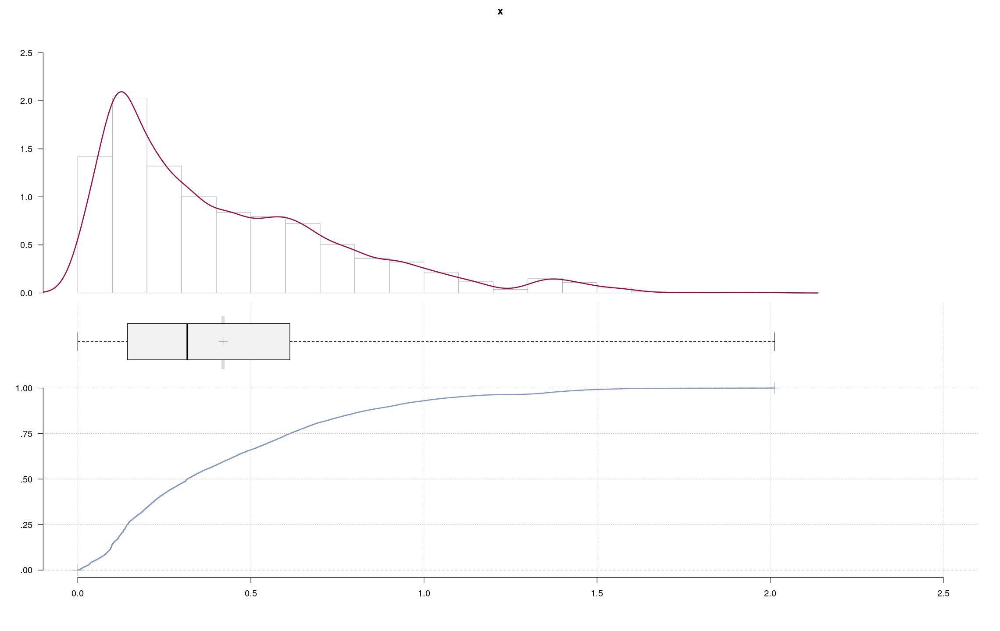

In [20]:
options(repr.plot.width=19, repr.plot.height=12)

PlotFdist(x = x, args.boxplot = list(range = coefficient_iqr))

In [88]:
modes_object <- calculate_modes(x = x)

names(modes_object)

[1] "density_values"          "density_support"        
[3] "density_maxima"          "density_maxima_argument"
[5] "density_minima"          "density_minima_argument"

In [89]:
extrema <- data.frame("modes" = modes_object$density_maxima_argument, "maxima" = modes_object$density_maxima)
rownames(extrema) <- 1:nrow(extrema)
extrema

,modes,maxima
,<dbl>,<dbl>
1,0.1261459829,2.02854298269
2,0.5734794362,0.77715453514
3,1.3736784085,0.14339013502
4,1.9299278330,0.08341812394


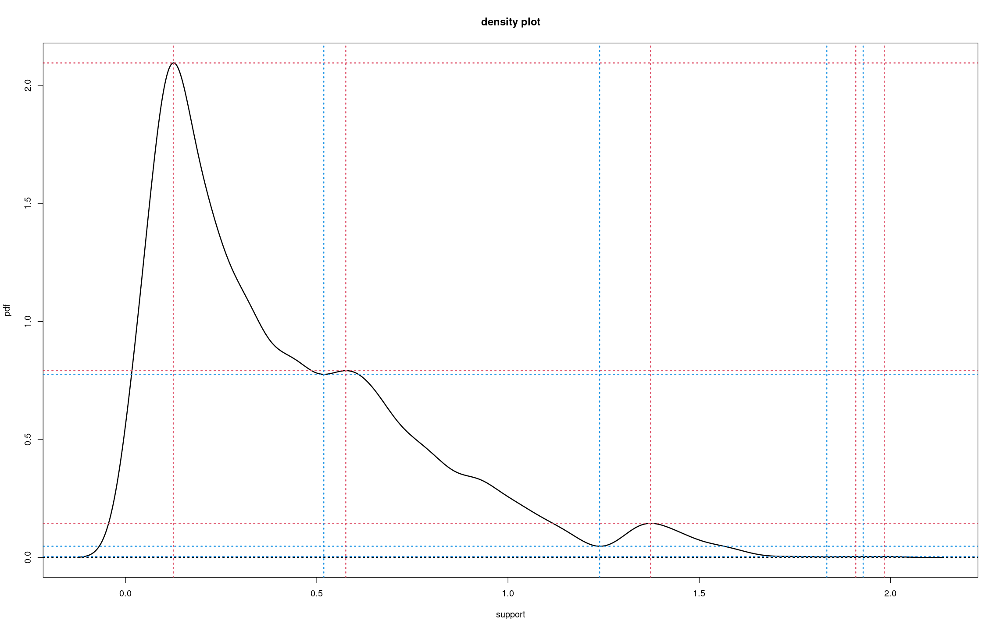

In [23]:
plot_modes(modes_object)

In [90]:
outlier_values <- data_processed_object$outlier_values

describe(outlier_values)

outlier_values 
       n  missing distinct     Info     Mean      Gmd      .05      .10 
     415        0      415        1    9.562    6.367    2.121    2.185 
     .25      .50      .75      .90      .95 
   4.892    8.026   15.319   15.375   17.414 

lowest : 2.02129 2.02751 2.03073 2.03464 2.038  
highest: 21.7967 21.895  22.055  22.0902 22.2734

In [91]:
outlier_substitutes <- data_processed_object$outlier_substitutes

outlier_values_df <- data.frame("outlier_values" = outlier_values, "outlier_substitutes" = outlier_substitutes)

DT::datatable(outlier_values_df)

HTML widgets cannot be represented in plain text (need html)

In [26]:
outlier_positions <- data_processed_object$outlier_positions

outlier_positions

[1]  2342  2343  2344  2345  2346  2347  2348  2349  2350  2351  2352  2353
 [13]  2354  2355  2356  2357  2358  2359  2360  2361  2362  2363  2364  2365
 [25]  2366  2367  2368  2369  2370  2371  2372  2373  2374  2375  2376  2377
 [37]  2378  2379  2380  2381  2382  2383  2384  2385  2386  2387  2388  2389
 [49]  2390  2391  2392  2393  2394  2395  2396  2397  2398  2399  2400  2401
 [61]  2402  2403  2404  2405  2406  2407  2408  2409  2410  2411  2412  2413
 [73]  2414  2415  2416  2417  4810  4811  4812  4813  4814  4815  4816  4817
 [85]  4818  4819  4820  4821  4822  4823  4824  4825  4826  4827  4828  4829
 [97]  4830  4831  4832  4833 13506 16571 16572 16573 16574 16575 16576 16577
[109] 16578 16579 16598 16599 16600 16601 16602 16603 16604 16605 16606 16607
[121] 16608 16609 16610 16611 16612 16613 16614 16615 16616 16617 16618 16619
[133] 16620 16621 16622 16623 16624 16625 16626 16627 16628 16629 16630 16631
[145] 16632 16633 16634 16635 16636 16637 16638 16639 16640 16641 16642 16643
[157] 16644 16645 16646 16647 16648 16649 16650 16651 16652 16653 16654 17446
[169] 17447 18387 18388 18389 18390 18391 18392 18393 18394 18395 18396 18397
[181] 18398 18399 18400 18401 18402 18403 18404 18405 18406 18407 18408 18409
[193] 18410 18411 18412 18413 18415 18416 18417 18418 18419 18420 18421 18422
[205] 18423 18424 18425 18426 18427 18428 18429 18430 18431 18432 18433 18434
[217] 18435 18436 18437 18438 18439 18440 18441 18442 18443 18444 18445 18446
[229] 18447 18448 18449 18450 18451 18452 18453 18454 18455 18456 18457 18458
[241] 18459 18460 18461 18462 18463 18464 18465 18466 18467 18468 18469 18470
[253] 18471 18472 18473 18474 18475 18476 18477 18478 18479 18480 18481 18482
[265] 18483 18484 18485 18486 18487 18488 18489 18490 18491 18492 18493 18494
[277] 18495 18496 18497 18498 18499 18500 18501 18502 18503 18504 18505 18506
[289] 18507 18508 18509 18510 18511 18512 18513 18514 18515 18516 18517 18518
[301] 18519 18520 18521 18522 18523 18524 18525 18526 18527 18528 18529 18530
[313] 18531 18532 18533 18534 18535 18536 18537 18538 18539 18540 18541 18542
[325] 18543 18544 18545 18546 18547 18548 18549 18550 18551 18552 18553 18554
[337] 18555 18556 18557 18558 18559 18560 18561 18562 18563 18564 18565 18566
[349] 18567 18568 18569 18570 18571 18572 18573 18574 18575 18576 18577 18578
[361] 18579 18580 18581 18582 18583 18584 18585 18586 18587 18588 18589 18590
[373] 18591 18592 18593 18594 18595 18596 18597 18598 18599 18600 18601 18602
[385] 18603 18604 18605 18606 18607 18608 18609 18610 18611 18612 18613 18614
[397] 18615 18616 18617 18618 18619 18624 16580 18620 18621 18622 18623 18625
[409] 18627 18628 18629 18630 18631 19840  2418

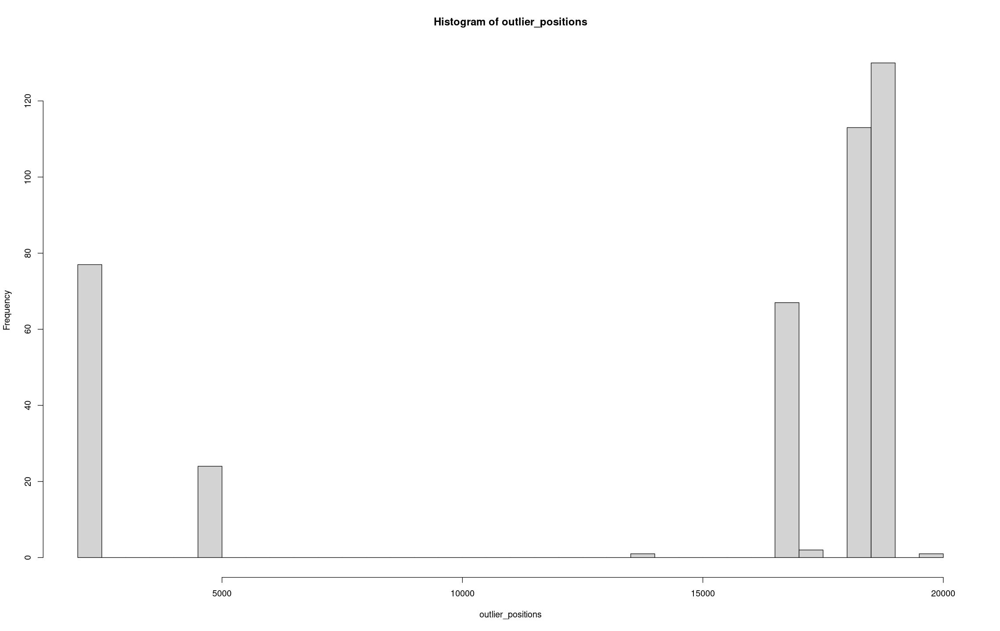

In [27]:
options(repr.plot.width=19, repr.plot.height=12)

hist(outlier_positions, nclass = 50)

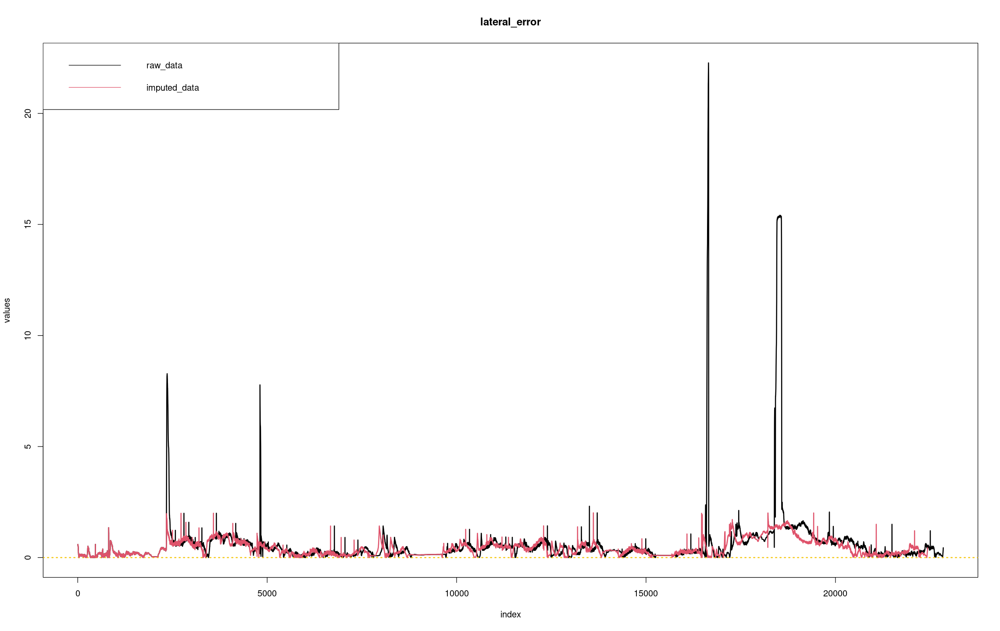

In [28]:
options(repr.plot.width=19, repr.plot.height=12)

plot(abs(data[, response_var]), 
     type = "l", 
     lwd = 2, 
     ylab = "values", 
     xlab = "index",
    main = paste(response_var))

abline(h = 0, lty = "dotted", col = 7, lwd = 2)

lines(x, col = 2, lwd = 2)

legend("topleft", legend = c("raw_data", "imputed_data"), col = c(1, 2), lty = 1:1, cex = 1)

## Predictor variables

In [174]:
# predictor variables
data_covariates <- data_processed_object$predictors

DT::datatable(data_covariates)

HTML widgets cannot be represented in plain text (need html)

In [175]:
detection_vars <- names(data)[c(11:45)]

data_covariates_detection <- data %>% select(all_of(detection_vars))

detection_vars_counts <- apply(data_covariates_detection, 2, sum)

names(detection_vars_counts) <- names(data_covariates_detection)

detection_vars_counts_df <- data.frame("total" = sort(detection_vars_counts, decreasing = TRUE))

detection_vars_counts_df

,total
,<int>
name_car,214982
name_street.light,196476
name_traffic.sign,183342
name_tree,123431
name_traffic.light,86870
name_tenement,85351
name_person,70605
name_tree..group.,65966
name_electric.pole,65461


# Model selection

## Candidate models

In [87]:
models_object <- c(list("model_00" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~1),
                        
                        "model_01" = list("location.fun" = ~object, "scale.fun" = ~object, "shape.fun" = ~object),
                        "model_02" = list("location.fun" = ~object, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_03" = list("location.fun" = ~1, "scale.fun" = ~object, "shape.fun" = ~1),
                        "model_04" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~object),
                        "model_05" = list("location.fun" = ~object, "scale.fun" = ~object, "shape.fun" = ~1),
                        "model_06" = list("location.fun" = ~object, "scale.fun" = ~1, "shape.fun" = ~object),
                        "model_07" = list("location.fun" = ~1, "scale.fun" = ~object, "shape.fun" = ~object),
                        
                        "model_08" = list("location.fun" = ~area, "scale.fun" = ~area, "shape.fun" = ~area),
                        "model_09" = list("location.fun" = ~area, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_10" = list("location.fun" = ~1, "scale.fun" = ~area, "shape.fun" = ~1),
                        "model_11" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~area),
                        "model_12" = list("location.fun" = ~area, "scale.fun" = ~area, "shape.fun" = ~1),
                        "model_13" = list("location.fun" = ~area, "scale.fun" = ~1, "shape.fun" = ~area),
                        "model_14" = list("location.fun" = ~1, "scale.fun" = ~area, "shape.fun" = ~area),
                        
                        "model_15" = list("location.fun" = ~velocity, "scale.fun" = ~velocity, "shape.fun" = ~velocity),
                        "model_16" = list("location.fun" = ~velocity, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_17" = list("location.fun" = ~1, "scale.fun" = ~velocity, "shape.fun" = ~1),
                        "model_18" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~velocity),
                        "model_19" = list("location.fun" = ~velocity, "scale.fun" = ~velocity, "shape.fun" = ~1),
                        "model_20" = list("location.fun" = ~velocity, "scale.fun" = ~1, "shape.fun" = ~velocity),
                        "model_21" = list("location.fun" = ~1, "scale.fun" = ~velocity, "shape.fun" = ~velocity),
                        
                        "model_22" = list("location.fun" = ~horizontal_left, "scale.fun" = ~horizontal_left, "shape.fun" = ~horizontal_left),
                        "model_23" = list("location.fun" = ~horizontal_left, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_24" = list("location.fun" = ~1, "scale.fun" = ~horizontal_left, "shape.fun" = ~1),
                        "model_25" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~horizontal_left),
                        "model_26" = list("location.fun" = ~horizontal_left, "scale.fun" = ~horizontal_left, "shape.fun" = ~1),
                        "model_27" = list("location.fun" = ~horizontal_left, "scale.fun" = ~1, "shape.fun" = ~horizontal_left),
                        "model_28" = list("location.fun" = ~1, "scale.fun" = ~horizontal_left, "shape.fun" = ~horizontal_left),
                        
                        "model_29" = list("location.fun" = ~horizontal_right, "scale.fun" = ~horizontal_right, "shape.fun" = ~horizontal_right),
                        "model_30" = list("location.fun" = ~horizontal_right, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_31" = list("location.fun" = ~1, "scale.fun" = ~horizontal_right, "shape.fun" = ~1),
                        "model_32" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~horizontal_right),
                        "model_33" = list("location.fun" = ~horizontal_right, "scale.fun" = ~horizontal_right, "shape.fun" = ~1),
                        "model_34" = list("location.fun" = ~horizontal_right, "scale.fun" = ~1, "shape.fun" = ~horizontal_right),
                        "model_35" = list("location.fun" = ~1, "scale.fun" = ~horizontal_right, "shape.fun" = ~horizontal_right),
                        
                        "model_36" = list("location.fun" = ~vertical_up, "scale.fun" = ~vertical_up, "shape.fun" = ~vertical_up),
                        "model_37" = list("location.fun" = ~vertical_up, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_38" = list("location.fun" = ~1, "scale.fun" = ~vertical_up, "shape.fun" = ~1),
                        "model_39" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~vertical_up),
                        "model_40" = list("location.fun" = ~vertical_up, "scale.fun" = ~vertical_up, "shape.fun" = ~1),
                        "model_41" = list("location.fun" = ~vertical_up, "scale.fun" = ~1, "shape.fun" = ~vertical_up),
                        "model_42" = list("location.fun" = ~1, "scale.fun" = ~vertical_up, "shape.fun" = ~vertical_up),
                        
                        "model_43" = list("location.fun" = ~vertical_down, "scale.fun" = ~vertical_down, "shape.fun" = ~vertical_down),
                        "model_44" = list("location.fun" = ~vertical_down, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_45" = list("location.fun" = ~1, "scale.fun" = ~vertical_down, "shape.fun" = ~1),
                        "model_46" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~vertical_down),
                        "model_47" = list("location.fun" = ~vertical_down, "scale.fun" = ~vertical_down, "shape.fun" = ~1),
                        "model_48" = list("location.fun" = ~vertical_down, "scale.fun" = ~1, "shape.fun" = ~vertical_down),
                        "model_49" = list("location.fun" = ~1, "scale.fun" = ~vertical_down, "shape.fun" = ~vertical_down),
                        
                        "model_50" = list("location.fun" = ~name_car, "scale.fun" = ~name_car, "shape.fun" = ~name_car),
                        "model_51" = list("location.fun" = ~name_car, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_52" = list("location.fun" = ~1, "scale.fun" = ~name_car, "shape.fun" = ~1),
                        "model_53" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_car),
                        "model_54" = list("location.fun" = ~name_car, "scale.fun" = ~name_car, "shape.fun" = ~1),
                        "model_55" = list("location.fun" = ~name_car, "scale.fun" = ~1, "shape.fun" = ~name_car),
                        "model_56" = list("location.fun" = ~1, "scale.fun" = ~name_car, "shape.fun" = ~name_car),
                        
                        "model_57" = list("location.fun" = ~name_street.light, "scale.fun" = ~name_street.light, "shape.fun" = ~name_street.light),
                        "model_58" = list("location.fun" = ~name_street.light, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_59" = list("location.fun" = ~1, "scale.fun" = ~name_street.light, "shape.fun" = ~1),
                        "model_60" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_street.light),
                        "model_61" = list("location.fun" = ~name_street.light, "scale.fun" = ~name_street.light, "shape.fun" = ~1),
                        "model_62" = list("location.fun" = ~name_street.light, "scale.fun" = ~1, "shape.fun" = ~name_street.light),
                        "model_63" = list("location.fun" = ~1, "scale.fun" = ~name_street.light, "shape.fun" = ~name_street.light),
                        
                        "model_64" = list("location.fun" = ~name_traffic.sign, "scale.fun" = ~name_traffic.sign, "shape.fun" = ~name_traffic.sign),
                        "model_65" = list("location.fun" = ~name_traffic.sign, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_66" = list("location.fun" = ~1, "scale.fun" = ~name_traffic.sign, "shape.fun" = ~1),
                        "model_67" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_traffic.sign),
                        "model_68" = list("location.fun" = ~name_traffic.sign, "scale.fun" = ~name_traffic.sign, "shape.fun" = ~1),
                        "model_69" = list("location.fun" = ~name_traffic.sign, "scale.fun" = ~1, "shape.fun" = ~name_traffic.sign),
                        "model_70" = list("location.fun" = ~1, "scale.fun" = ~name_traffic.sign, "shape.fun" = ~name_traffic.sign),
                        
                        "model_71" = list("location.fun" = ~name_tree, "scale.fun" = ~name_tree, "shape.fun" = ~name_tree),
                        "model_72" = list("location.fun" = ~name_tree, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_73" = list("location.fun" = ~1, "scale.fun" = ~name_tree, "shape.fun" = ~1),
                        "model_74" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_tree),
                        "model_75" = list("location.fun" = ~name_tree, "scale.fun" = ~name_tree, "shape.fun" = ~1),
                        "model_76" = list("location.fun" = ~name_tree, "scale.fun" = ~1, "shape.fun" = ~name_tlateral_errorree),
                        "model_77" = list("location.fun" = ~1, "scale.fun" = ~name_tree, "shape.fun" = ~name_tree),
                        
                        "model_78" = list("location.fun" = ~name_tenement, "scale.fun" = ~name_tenement, "shape.fun" = ~name_tenement),
                        "model_79" = list("location.fun" = ~name_tenement, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_80" = list("location.fun" = ~1, "scale.fun" = ~name_tenement, "shape.fun" = ~1),
                        "model_81" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_tenement),
                        "model_82" = list("location.fun" = ~name_tenement, "scale.fun" = ~name_tenement, "shape.fun" = ~1),
                        "model_83" = list("location.fun" = ~name_tenement, "scale.fun" = ~1, "shape.fun" = ~name_tenement),
                        "model_84" = list("location.fun" = ~1, "scale.fun" = ~name_tenement, "shape.fun" = ~name_tenement),
                        
                        "model_85" = list("location.fun" = ~name_tree..group., "scale.fun" = ~name_tree..group., "shape.fun" = ~name_tree..group.),
                        "model_86" = list("location.fun" = ~name_tree..group., "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_87" = list("location.fun" = ~1, "scale.fun" = ~name_tree..group., "shape.fun" = ~1),
                        "model_88" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_tree..group.),
                        "model_89" = list("location.fun" = ~name_tree..group., "scale.fun" = ~name_tree..group., "shape.fun" = ~1),
                        "model_90" = list("location.fun" = ~name_tree..group., "scale.fun" = ~1, "shape.fun" = ~name_tree..group.),
                        "model_91" = list("location.fun" = ~1, "scale.fun" = ~name_tree..group., "shape.fun" = ~name_tree..group.),
                        
                        "model_92" = list("location.fun" = ~name_traffic.light, "scale.fun" = ~name_traffic.light, "shape.fun" = ~name_traffic.light),
                        "model_93" = list("location.fun" = ~name_traffic.light, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_94" = list("location.fun" = ~1, "scale.fun" = ~name_traffic.light, "shape.fun" = ~1),
                        "model_95" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_traffic.light),
                        "model_96" = list("location.fun" = ~name_traffic.light, "scale.fun" = ~name_traffic.light, "shape.fun" = ~1),
                        "model_97" = list("location.fun" = ~name_traffic.light, "scale.fun" = ~1, "shape.fun" = ~name_traffic.light),
                        "model_98" = list("location.fun" = ~1, "scale.fun" = ~name_traffic.light, "shape.fun" = ~name_traffic.light),
                        
                        "model_99" = list("location.fun" = ~name_electric.pole, "scale.fun" = ~name_electric.pole, "shape.fun" = ~name_electric.pole),
                        "model_100" = list("location.fun" = ~name_electric.pole, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_101" = list("location.fun" = ~1, "scale.fun" = ~name_electric.pole, "shape.fun" = ~1),
                        "model_102" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_electric.pole),
                        "model_103" = list("location.fun" = ~name_electric.pole, "scale.fun" = ~name_electric.pole, "shape.fun" = ~1),
                        "model_104" = list("location.fun" = ~name_electric.pole, "scale.fun" = ~1, "shape.fun" = ~name_electric.pole),
                        "model_105" = list("location.fun" = ~1, "scale.fun" = ~name_electric.pole, "shape.fun" = ~name_electric.pole),
                        
                        "model_106" = list("location.fun" = ~name_fence, "scale.fun" = ~name_fence, "shape.fun" = ~name_fence),
                        "model_107" = list("location.fun" = ~name_fence, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_108" = list("location.fun" = ~1, "scale.fun" = ~name_fence, "shape.fun" = ~1),
                        "model_109" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_fence),
                        "model_110" = list("location.fun" = ~name_fence, "scale.fun" = ~name_fence, "shape.fun" = ~1),
                        "model_111" = list("location.fun" = ~name_fence, "scale.fun" = ~1, "shape.fun" = ~name_fence),
                        "model_112" = list("location.fun" = ~1, "scale.fun" = ~name_fence, "shape.fun" = ~name_fence),
                        
                        "model_113" = list("location.fun" = ~name_person, "scale.fun" = ~name_person, "shape.fun" = ~name_person),
                        "model_114" = list("location.fun" = ~name_person, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_115" = list("location.fun" = ~1, "scale.fun" = ~name_person, "shape.fun" = ~1),
                        "model_116" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_person),
                        "model_117" = list("location.fun" = ~name_person, "scale.fun" = ~name_person, "shape.fun" = ~1),
                        "model_118" = list("location.fun" = ~name_person, "scale.fun" = ~1, "shape.fun" = ~name_person),
                        "model_119" = list("location.fun" = ~1, "scale.fun" = ~name_person, "shape.fun" = ~name_person),
                        
                        "model_120" = list("location.fun" = ~name_truck, "scale.fun" = ~name_truck, "shape.fun" = ~name_truck),
                        "model_121" = list("location.fun" = ~name_truck, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_122" = list("location.fun" = ~1, "scale.fun" = ~name_truck, "shape.fun" = ~1),
                        "model_123" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_truck),
                        "model_124" = list("location.fun" = ~name_truck, "scale.fun" = ~name_truck, "shape.fun" = ~1),
                        "model_125" = list("location.fun" = ~name_truck, "scale.fun" = ~1, "shape.fun" = ~name_truck),
                        "model_126" = list("location.fun" = ~1, "scale.fun" = ~name_truck, "shape.fun" = ~name_truck),
                        
                        "model_127" = list("location.fun" = ~name_car..group., "scale.fun" = ~name_car..group., "shape.fun" = ~name_car..group.),
                        "model_128" = list("location.fun" = ~name_car..group., "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_129" = list("location.fun" = ~1, "scale.fun" = ~name_car..group., "shape.fun" = ~1),
                        "model_130" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_car..group.),
                        "model_131" = list("location.fun" = ~name_car..group., "scale.fun" = ~name_car..group., "shape.fun" = ~1),
                        "model_132" = list("location.fun" = ~name_car..group., "scale.fun" = ~1, "shape.fun" = ~name_car..group.),
                        "model_133" = list("location.fun" = ~1, "scale.fun" = ~name_car..group., "shape.fun" = ~name_car..group.),
                        
                        "model_134" = list("location.fun" = ~name_house..group., "scale.fun" = ~name_house..group., "shape.fun" = ~name_house..group.),
                        "model_135" = list("location.fun" = ~name_house..group., "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_136" = list("location.fun" = ~1, "scale.fun" = ~name_house..group., "shape.fun" = ~1),
                        "model_137" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_house..group.),
                        "model_138" = list("location.fun" = ~name_house..group., "scale.fun" = ~name_house..group., "shape.fun" = ~1),
                        "model_139" = list("location.fun" = ~name_house..group., "scale.fun" = ~1, "shape.fun" = ~name_house..group.),
                        "model_140" = list("location.fun" = ~1, "scale.fun" = ~name_house..group., "shape.fun" = ~name_house..group.),
                        
                        "model_141" = list("location.fun" = ~name_house, "scale.fun" = ~name_house, "shape.fun" = ~name_house),
                        "model_142" = list("location.fun" = ~name_house, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_143" = list("location.fun" = ~1, "scale.fun" = ~name_house, "shape.fun" = ~1),
                        "model_144" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_house),
                        "model_145" = list("location.fun" = ~name_house, "scale.fun" = ~name_house, "shape.fun" = ~1),
                        "model_146" = list("location.fun" = ~name_house, "scale.fun" = ~1, "shape.fun" = ~name_house),
                        "model_147" = list("location.fun" = ~1, "scale.fun" = ~name_house, "shape.fun" = ~name_house),
                        
                        "model_148" = list("location.fun" = ~name_bus, "scale.fun" = ~name_bus, "shape.fun" = ~name_bus),
                        "model_149" = list("location.fun" = ~name_bus, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_150" = list("location.fun" = ~1, "scale.fun" = ~name_bus, "shape.fun" = ~1),
                        "model_151" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_bus),
                        "model_152" = list("location.fun" = ~name_bus, "scale.fun" = ~name_bus, "shape.fun" = ~1),
                        "model_153" = list("location.fun" = ~name_bus, "scale.fun" = ~1, "shape.fun" = ~name_bus),
                        "model_154" = list("location.fun" = ~1, "scale.fun" = ~name_bus, "shape.fun" = ~name_bus),
                        
                        "model_155" = list("location.fun" = ~name_special.building, "scale.fun" = ~name_special.building, "shape.fun" = ~name_special.building),
                        "model_156" = list("location.fun" = ~name_special.building, "scale.fun" = ~1, "shape.fun" = ~1),
                        "model_157" = list("location.fun" = ~1, "scale.fun" = ~name_special.building, "shape.fun" = ~1),
                        "model_158" = list("location.fun" = ~1, "scale.fun" = ~1, "shape.fun" = ~name_special.building),
                        "model_159" = list("location.fun" = ~name_special.building, "scale.fun" = ~name_special.building, "shape.fun" = ~1),
                        "model_160" = list("location.fun" = ~name_special.building, "scale.fun" = ~1, "shape.fun" = ~name_special.building),
                        "model_161" = list("location.fun" = ~1, "scale.fun" = ~name_special.building, "shape.fun" = ~name_special.building)))


## Identification

In [176]:
model_ids_longitudinal_error <- rownames(longitudinal_error_model_information_criterion_aggregated)
model_ids_lateral_error <- rownames(lateral_error_model_information_criterion_aggregated)

model_ids <- unique(c(model_ids_longitudinal_error, model_ids_lateral_error))

In [177]:
length(model_ids)

[1] 162

In [178]:
model_id <- "model_07_name_fence"

model_uid <- paste(experimentation, model_id, sep = "_")

model_uid

[1] "experimentation_02_model_07_name_fence"

In [179]:
# extract the selected model
if (response_var == "lateral_error"){
    model_selected_index <- which(lateral_error_model_information_criterion_merged$model_uid == model_uid)
    model_selected <- lateral_error_model_information_criterion_merged %>% slice(model_selected_index)
} else if (response_var == "longitudinal_error"){
    model_selected_index <- which(longitudinal_error_model_information_criterion_merged$model_uid == model_uid)
    model_selected <- longitudinal_error_model_information_criterion_merged %>% slice(model_selected_index)
} else {
    stop("Sorry, incorrect entry for the argument 'response_var'")
}


In [180]:
model_selected

,model_uid,model_id,location.fun,scale.fun,shape.fun,AIC,BIC,variable,experimentation
,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>
523,experimentation_02_model_07_name_fence,model_07_name_fence,~1,~name_fence,~name_fence,311.4304604,3101.361566,name_fence,experimentation_02


In [181]:
selected_model_variable <- model_selected$variable

selected_model_variable

[1] "name_fence"

## Estimation

In [182]:
use.phi <- TRUE
nlargest <- 20000
y <- extract_nlargest_sample(x, n = nlargest)
block_sizes <- NULL
minimum_nblocks <- 50
threshold <- min(y)
confidence_level <- 0.95
use_extremal_index <- TRUE
use_uniform_prior <- TRUE
method <- "MLE"

In [183]:
defaultW <- getOption("warn") 

options(warn = -1) 

ns_gev_mixture_model_object <- fit_non_stationary_gev_mixture_model(x = x,
                                                                    data = data_covariates,
                                                                    location.fun = as.formula(model_selected$location.fun),
                                                                    scale.fun = as.formula(model_selected$scale.fun),
                                                                    shape.fun = as.formula(model_selected$shape.fun),
                                                                    use.phi = use.phi,
                                                                    nlargest = nlargest,
                                                                    block_sizes = block_sizes,
                                                                    minimum_nblocks = minimum_nblocks,
                                                                    threshold = threshold,
                                                                    confidence_level = confidence_level,
                                                                    use_extremal_index = use_extremal_index,
                                                                    use_uniform_prior = use_uniform_prior,
                                                                    method = method)

options(warn = defaultW)

In [184]:
print(names(ns_gev_mixture_model_object))

 [1] "threshold"                            
 [2] "candidate_block_sizes"                
 [3] "equivalent_block_sizes"               
 [4] "unequivalent_block_sizes"             
 [5] "selected_block_sizes"                 
 [6] "unselected_block_sizes"               
 [7] "failed_block_sizes"                   
 [8] "use_uniform_prior"                    
 [9] "weights"                              
[10] "frequencies"                          
[11] "use_extremal_index"                   
[12] "extremal_indexes"                     
[13] "negative_log_likelihoods"             
[14] "information_criteria"                 
[15] "selected_ns_gev_coefficients"         
[16] "unnormalized_gev_parameters_object"   
[17] "normalized_gev_parameters_object"     
[18] "full_normalized_gev_parameters_object"
[19] "selected_model_per_obs"               
[20] "all_data_covariates"                  
[21] "partial_data_covariates"              
[22] "partial_data"                         
[23] "all_

In [185]:
selected_ns_gev_coefficients <- ns_gev_mixture_model_object$selected_ns_gev_coefficients
selected_ns_gev_coefficients

,location,phi0,phi1,xi0,xi1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3,0.3524952599,-1.972131193,-0.038886834726,0.230789919053,-0.008014026421
4,0.3567339878,-1.966514508,-0.043441445988,0.223267913386,-0.006278252217
5,0.3599867352,-1.968122931,-0.045270207756,0.223552292016,-0.001985848248
6,0.3627312542,-1.964552267,-0.047237801567,0.219845955292,-0.004039814014
9,0.3697802623,-1.961043347,-0.046176100361,0.215252673599,0.002920153139
10,0.3718281016,-1.959042122,-0.047058676047,0.212740842156,0.005342436486
12,0.3749687528,-1.956159928,-0.051203196573,0.213284667582,0.014411036868
14,0.3796167163,-1.955142715,-0.044961337427,0.208633103590,0.023397146665
16,0.3831303585,-1.947905999,-0.045885495613,0.201837965166,0.023602680287


In [186]:
data.frame("weights" = ns_gev_mixture_model_object$weights)

,weights
,<dbl>
3,1.191493640e-01
4,1.005479865e-04
5,2.010959731e-04
6,4.228042833e-02
9,1.860137751e-03
10,2.362877683e-03
12,2.669549042e-02
14,7.088633050e-03
16,1.407671811e-03


In [187]:
highest_weighted_model <- which.max(ns_gev_mixture_model_object$weights)

highest_weighted_model

3 
1

In [189]:
model_quality <- round(ns_gev_mixture_model_object$information_criteria, 3)

model_quality

AIC      BIC 
 311.430 3101.362

## Diagnostic

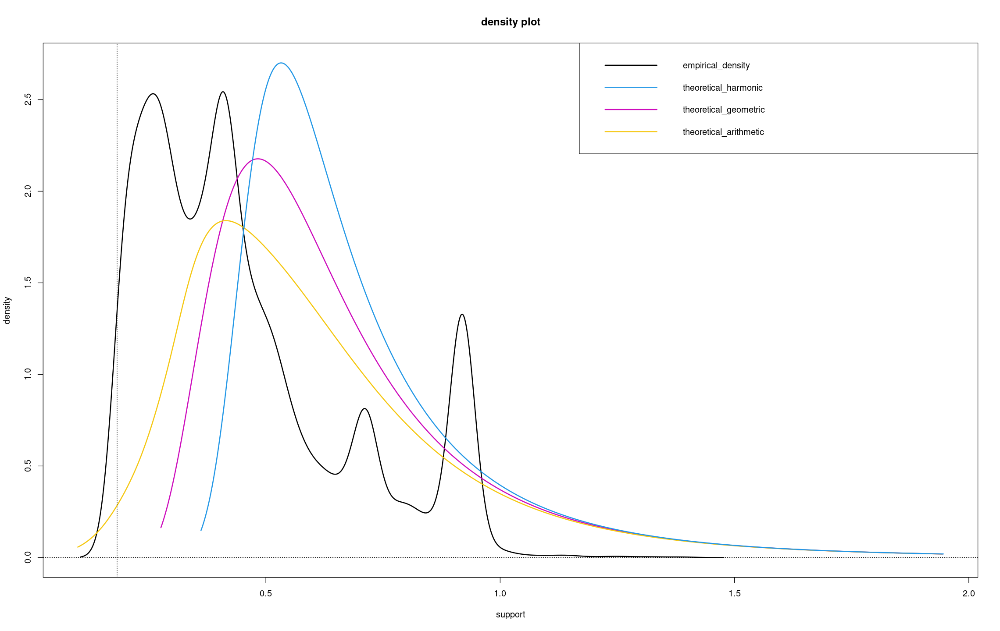

In [190]:
options(repr.plot.width=19, repr.plot.height=12)

plot_fit_non_stationary_gev_mixture_model(ns_gev_mixture_model_object,
                                          data_index = 0,
                                          model_index = 0,
                                          zoom_thresholds = c(-Inf, +Inf),
                                          xlab = "support",
                                          ylab = "density",
                                          main = "density plot",
                                          legend_position = "topright")

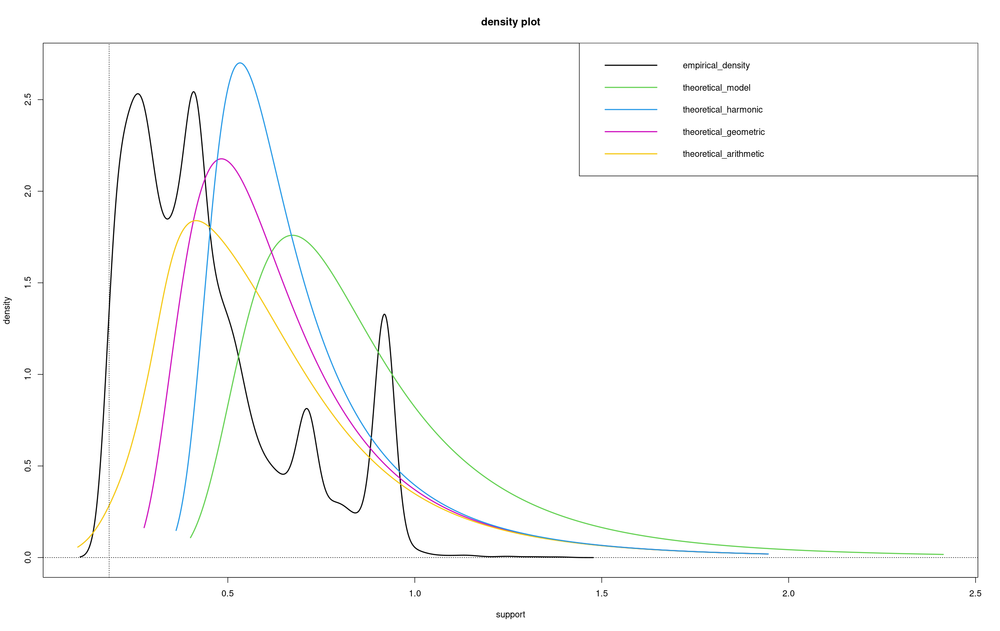

In [191]:
options(repr.plot.width=19, repr.plot.height=12)

plot_fit_non_stationary_gev_mixture_model(ns_gev_mixture_model_object,
                                          data_index = 0,
                                          model_index = highest_weighted_model,
                                          zoom_thresholds = c(-Inf, +Inf),
                                          xlab = "support",
                                          ylab = "density",
                                          main = "density plot",
                                          legend_position = "topright")

# Quantiles

## Quantile order: alpha = n^(-1)

In [194]:
n <- length(x)

alpha <- n^(-1)

print(alpha)

[1] 2.868946523e-05


## Quantiles vs covariates

In [195]:
partial_data_covariates <- ns_gev_mixture_model_object$partial_data_covariates

partial_data_covariates_variable <- partial_data_covariates |> select(all_of(selected_model_variable))

describe(partial_data_covariates_variable)

partial_data_covariates_variable 

 1  Variables      20000  Observations
--------------------------------------------------------------------------------
name_fence 
       n  missing distinct     Info     Mean      Gmd      .05      .10 
   20000        0       14    0.917 -0.05187    0.953  -0.8799  -0.8799 
     .25      .50      .75      .90      .95 
 -0.8799  -0.2271   0.4258   1.0787   1.7315 

-0.879943694479549 (7384, 0.369), -0.227070763706668 (6009, 0.300),
0.425802167066212 (3518, 0.176), 1.07867509783909 (1555, 0.078),
1.73154802861197 (838, 0.042), 2.38442095938485 (307, 0.015), 3.03729389015773
(192, 0.010), 3.69016682093062 (81, 0.004), 4.3430397517035 (46, 0.002),
4.99591268247638 (37, 0.002), 5.64878561324926 (18, 0.001), 6.30165854402214
(11, 0.001), 6.95453147479502 (3, 0.000), 7.6074044055679 (1, 0.000)

For the frequency table, variable is rounded to the nearest 0
--------------------------------------------------------------------------------

In [196]:
range(partial_data_covariates_variable)

[1] -0.8799436945  7.6074044056

In [197]:
variable_values <- seq(from = min(partial_data_covariates_variable),
                       to = max(partial_data_covariates_variable),
                       length.out = 100)

new_covariates_values <- data.frame(variable_values)

names(new_covariates_values) <- selected_model_variable

describe(new_covariates_values)

new_covariates_values 

 1  Variables      100  Observations
--------------------------------------------------------------------------------
name_fence 
       n  missing distinct     Info     Mean      Gmd      .05      .10 
     100        0      100        1    3.364    2.886 -0.45558 -0.03121 
     .25      .50      .75      .90      .95 
 1.24189  3.36373  5.48557  6.75867  7.18304 

lowest : -0.879944 -0.794213 -0.708482 -0.622751 -0.537021
highest: 7.26448   7.35021   7.43594   7.52167   7.6074   
--------------------------------------------------------------------------------

In [198]:
defaultW <- getOption("warn") 

options(warn = -1) 

quantiles_new_covariates_values_list <- estimate_non_stationary_gev_mixture_model_quantile(ns_gev_mixture_model_object,
                                                                                           alpha = alpha,
                                                                                           data = new_covariates_values,
                                                                                           do.ci = FALSE,
                                                                                           confidence_level = 0.95,
                                                                                           kind = c("geometric", "arithmetic", "harmonic")[1],
                                                                                           iterations = 20)

quantiles_new_covariates_values <- sapply(quantiles_new_covariates_values_list, function(quantile){
  c("lower_bound" = quantile$smalest_lower_ci_bound, 
    "estimate" = quantile$gev_mixture_model_quantile, 
    "upper_bound" = quantile$largest_upper_ci_bound)
})

quantiles_new_covariates_values <- data.frame(t(quantiles_new_covariates_values))

DT::datatable(quantiles_new_covariates_values)

options(warn = defaultW)

HTML widgets cannot be represented in plain text (need html)

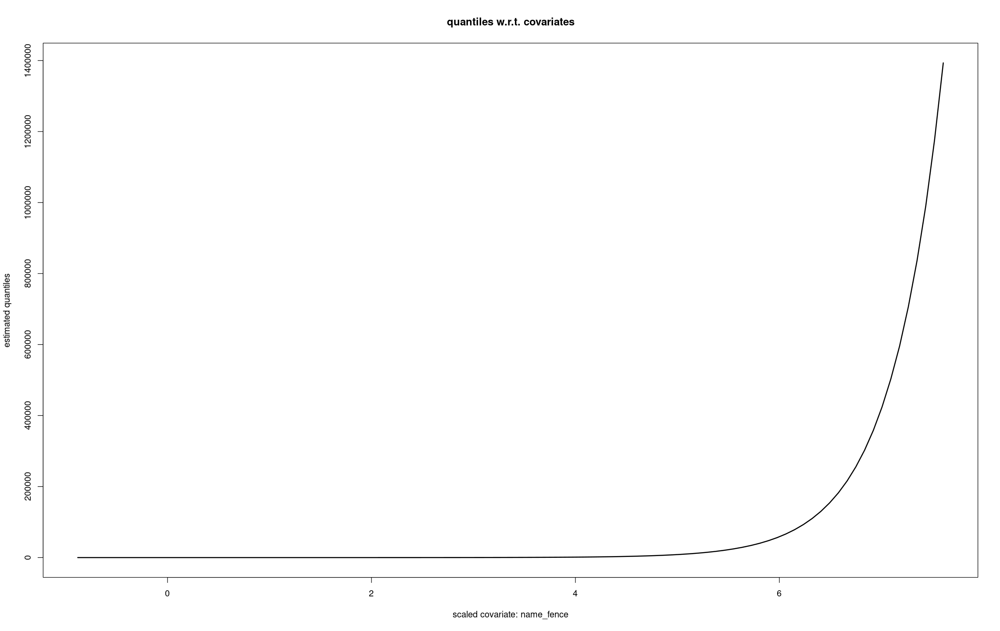

In [199]:
options(repr.plot.width=19, repr.plot.height=12)

plot(x = new_covariates_values[, selected_model_variable], 
        y = quantiles_new_covariates_values$estimate,
        type = "l",
        lty = 1,
        lwd = 2,
        main = "quantiles w.r.t. covariates",
        xlab = paste("scaled covariate:", selected_model_variable),
        ylab = "estimated quantiles")


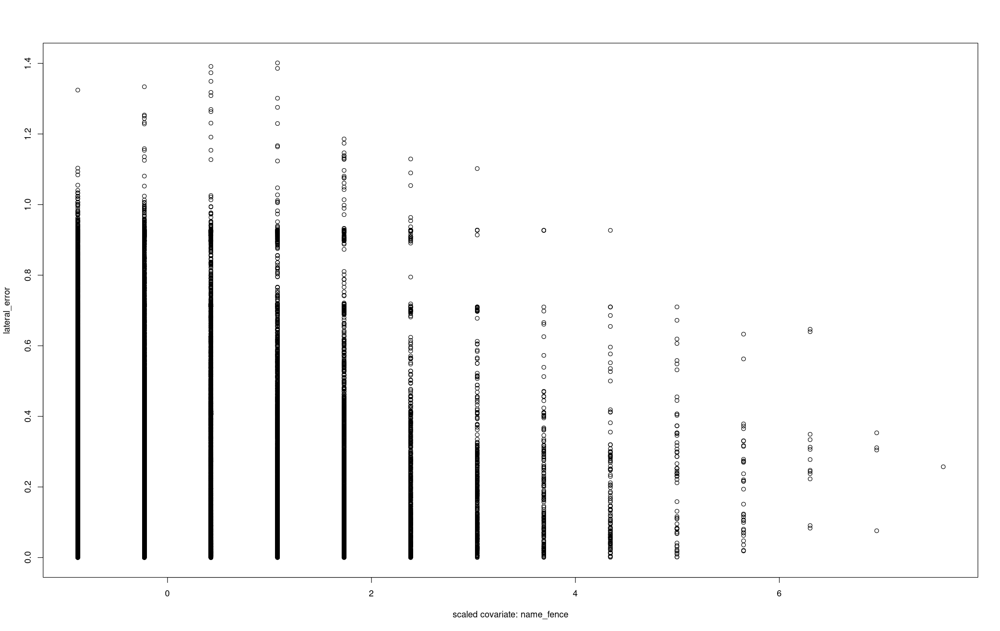

In [200]:
plot(x = data_covariates[, selected_model_variable], y = x, 
     ylab = response_var, xlab = paste("scaled covariate:", selected_model_variable))

In [136]:
# options(repr.plot.width=19, repr.plot.height=12)
# 
# matplot(x = new_covariates_values[, selected_model_variable], 
#         y = quantiles_new_covariates_values,
#         type = "l",
#         lty = 1,
#         lwd = 2,
#         main = "quantiles w.r.t. covariates",
#         xlab = paste("scaled covariate:", selected_model_variable),
#         ylab = "estimated quantiles")
# 
# legend("topleft", legend = c("lower_bound", "estimate", "upper_bound"), col = 1:3, lty = 1, lwd = 2, horiz = FALSE, bty = "n")

## Custom quantile

In [150]:
true_quantile <- NULL

print(true_quantile)

NULL


In [169]:
custom_covariates_scaled <- data.frame("var" = c(3, 4))

names(custom_covariates_scaled) <- selected_model_variable

custom_covariates_scaled

velocity
<dbl>
3
4


In [170]:
several_ns_gev_models <- ns_gev_mixture_model_object$selected_full_ns_gev_models

predicted_parameters <- get_several_ns_gev_model_normalized_parameters(several_ns_gev_models = several_ns_gev_models,
                                                                       data = custom_covariates_scaled,
                                                                       use_extremal_index = TRUE,
                                                                       normalize_parameters = TRUE)

# do.call(rbind, predicted_parameters)
predicted_parameters

location,scale,shape
<dbl>,<dbl>,<dbl>
0.7158974319,0.3119043683,0.3734242328
0.6868843064,0.2887348946,0.3734242328
location,scale,shape
<dbl>,<dbl>,<dbl>
0.8119142819,0.3484191880,0.3776675095
0.7746907544,0.3216732866,0.3776675095
location,scale,shape
<dbl>,<dbl>,<dbl>
0.8137440734,0.3308601111,0.3573538607


In [171]:
# index <- which.max(x)
# 
# new_data_covariates_scaled <- dplyr::slice(partial_data_covariates, index)
# 
# new_data_covariates_scaled |> select(all_of(selected_model_variable))

In [172]:
# several_ns_gev_models <- ns_gev_mixture_model_object$selected_full_ns_gev_models
# 
# predicted_parameters <- get_several_ns_gev_model_normalized_parameters(several_ns_gev_models = several_ns_gev_models,
#                                                                        data = new_data_covariates_scaled,
#                                                                        use_extremal_index = TRUE,
#                                                                        normalize_parameters = TRUE)
# 
# do.call(rbind, predicted_parameters)

In [173]:
results_geometric <- estimate_non_stationary_gev_mixture_model_quantile(ns_gev_mixture_model_object,
                                                                        alpha = alpha,
                                                                        data = custom_covariates_scaled,
                                                                        do.ci = TRUE,
                                                                        confidence_level = 0.95,
                                                                        kind = c("geometric", "arithmetic", "harmonic")[1],
                                                                        iterations = 100)

results_geometric

,lower_bound,estimate,upper_bound
,<dbl>,<dbl>,<dbl>
8,23.29874683021,40.784472734,58.270198637
9,25.67151084358,47.141731423,68.611952002
20,13.92140729327,39.675984091,65.430560889
211,1.29676970816,5.039608454,8.782447199
218,-1.13881255679,8.556383788,18.251580134
250,1.77082492083,4.315522566,6.860220211
270,0.08576434381,4.623110476,9.160456608
281,0.88633494184,4.144342106,7.402349270
286,2.32079747256,3.652204407,4.983611342


In [174]:
# results_arithmetic <- estimate_non_stationary_gev_mixture_model_quantile(ns_gev_mixture_model_object,
#                                                                          alpha = alpha,
#                                                                          data = custom_covariates_scaled,
#                                                                          do.ci = TRUE,
#                                                                          confidence_level = 0.95,
#                                                                          kind = c("geometric", "arithmetic", "harmonic")[2],
#                                                                          iterations = 100)
# 
# results_arithmetic

In [175]:
# results_harmonic <- estimate_non_stationary_gev_mixture_model_quantile(ns_gev_mixture_model_object,
#                                                                        alpha = alpha,
#                                                                        data = custom_covariates_scaled,
#                                                                        do.ci = TRUE,
#                                                                        confidence_level = 0.95,
#                                                                        kind = c("geometric", "arithmetic", "harmonic")[3],
#                                                                        iterations = 100)
# 
# results_harmonic

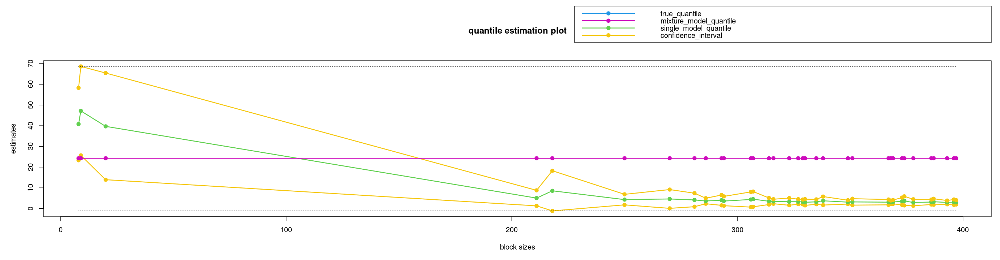

In [176]:
options(repr.plot.width=23, repr.plot.height=6)

plot_estimate_non_stationary_gev_mixture_model_quantile(ns_gev_mixture_model_object,
                                                        alpha = alpha,
                                                        data = custom_covariates_scaled,
                                                        data_index = 1,
                                                        true_quantile = NULL,
                                                        do.ci = TRUE,
                                                        confidence_level = 0.95,
                                                        kind = c("geometric", "arithmetic", "harmonic")[1],
                                                        iterations = 100,
                                                        xlab = "block sizes",
                                                        ylab = "estimates",
                                                        main = "quantile estimation plot",
                                                        legend_position = "topright")


# UDF GEV mixture model

## Formulation

In [116]:
# response variable
x <- data_object$response

In [109]:
# list of potential covariates
data_covariates <- data_object$predictors

names(data_covariates)

[1] "velocity"              "object"                "area"                 
 [4] "horizontal_left"       "horizontal_right"      "vertical_down"        
 [7] "vertical_up"           "name_airplane"         "name_bench"           
[10] "name_bench..group."    "name_bicycle"          "name_bird"            
[13] "name_bird..group."     "name_boat"             "name_bus"             
[16] "name_car"              "name_car..group."      "name_dog"             
[19] "name_electric.pole"    "name_fence"            "name_fire.hydrant"    
[22] "name_gas.station"      "name_helicopter"       "name_house"           
[25] "name_house..group."    "name_motorcycle"       "name_parking.meter"   
[28] "name_person"           "name_person..group."   "name_scooter"         
[31] "name_special.building" "name_stop.sign"        "name_street.light"    
[34] "name_tenement"         "name_traffic.light"    "name_traffic.sign"    
[37] "name_train"            "name_tree"             "name_tree..group."    
[40] "name_truck"            "name_tunnel"           "name_tunnel.entrance"

In [122]:
# model specification
custom_model <- list("location.fun" = ~object + velocity + name_tenement + name_tree, "scale.fun" = ~1, "shape.fun" = ~1)

custom_model

$location.fun
~object + velocity + name_tenement + name_tree

$scale.fun
~1

$shape.fun
~1


## Hyperparameters

In [123]:
use.phi <- TRUE
nlargest <- 20000
y <- extract_nlargest_sample(x, n = nlargest)
block_sizes <- NULL
minimum_nblocks <- 50
threshold <- min(y)
confidence_level <- 0.95
use_extremal_index <- TRUE
use_uniform_prior <- TRUE
method <- "MLE"

## Estimation

In [124]:
defaultW <- getOption("warn") 

options(warn = -1) 

ns_gev_mixture_model_object <- fit_non_stationary_gev_mixture_model(x = x,
                                                                    data = data_covariates,
                                                                    location.fun = as.formula(custom_model$location.fun),
                                                                    scale.fun = as.formula(custom_model$scale.fun),
                                                                    shape.fun = as.formula(custom_model$shape.fun),
                                                                    use.phi = use.phi,
                                                                    nlargest = nlargest,
                                                                    block_sizes = block_sizes,
                                                                    minimum_nblocks = minimum_nblocks,
                                                                    threshold = threshold,
                                                                    confidence_level = confidence_level,
                                                                    use_extremal_index = use_extremal_index,
                                                                    use_uniform_prior = use_uniform_prior,
                                                                    method = method)

options(warn = defaultW)

In [125]:
print(names(ns_gev_mixture_model_object))

 [1] "threshold"                            
 [2] "candidate_block_sizes"                
 [3] "equivalent_block_sizes"               
 [4] "unequivalent_block_sizes"             
 [5] "selected_block_sizes"                 
 [6] "unselected_block_sizes"               
 [7] "failed_block_sizes"                   
 [8] "use_uniform_prior"                    
 [9] "weights"                              
[10] "frequencies"                          
[11] "use_extremal_index"                   
[12] "extremal_indexes"                     
[13] "negative_log_likelihoods"             
[14] "information_criteria"                 
[15] "selected_ns_gev_coefficients"         
[16] "unnormalized_gev_parameters_object"   
[17] "normalized_gev_parameters_object"     
[18] "full_normalized_gev_parameters_object"
[19] "selected_model_per_obs"               
[20] "all_data_covariates"                  
[21] "partial_data_covariates"              
[22] "partial_data"                         
[23] "all_

In [126]:
ns_gev_mixture_model_object$selected_ns_gev_coefficients

,mu0,mu1,mu2,mu3,mu4,scale,shape
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
125,0.5498217215,-0.06495010090,0.11206784636,0.0222596780123,0.0063546724027,0.3146182353,0.119816542589
142,0.5794319523,-0.06857984961,0.09834981937,0.0436375688076,-0.0286229460209,0.3318475106,0.089141173680
171,0.6119841809,-0.08053933726,0.13027694782,0.0483674823228,-0.0378462300152,0.3499132445,0.052673222179
185,0.6291050025,-0.05757964672,0.13933366307,-0.0033925731369,-0.0009344572587,0.3706733951,-0.002654848272
188,0.6152114655,-0.06038653655,0.11710365037,0.0172607294911,0.0052882494290,0.3490389287,0.103269346283
193,0.6473761100,-0.02973177513,0.13492019629,-0.0271776323111,-0.0154821129743,0.3815647695,0.026959388838
199,0.6274716757,-0.05592750713,0.10397982014,-0.0089808338459,-0.0019268499014,0.3616253822,0.089278398442
202,0.6476297280,-0.06951062673,0.15913207225,0.0018401055536,0.0042132683073,0.3482320563,0.067523762946
205,0.6809970185,-0.04338143078,0.14289069026,0.0066081019028,-0.0478249147081,0.3878265255,-0.045484291405


In [127]:
data.frame("weights" = ns_gev_mixture_model_object$weights)

,weights
,<dbl>
125,1.000350123e-04
142,1.300455159e-03
171,2.450857800e-03
185,7.752713450e-03
188,3.971389986e-02
193,1.900665233e-03
199,5.752013205e-03
202,6.452258290e-03
205,1.065372881e-02


In [128]:
highest_weighted_model <- which.max(ns_gev_mixture_model_object$weights)

highest_weighted_model

366 
 69

In [129]:
model_quality <- round(ns_gev_mixture_model_object$information_criteria, 3)

model_quality

AIC       BIC 
 8902.935 14079.719

## Diagnostic

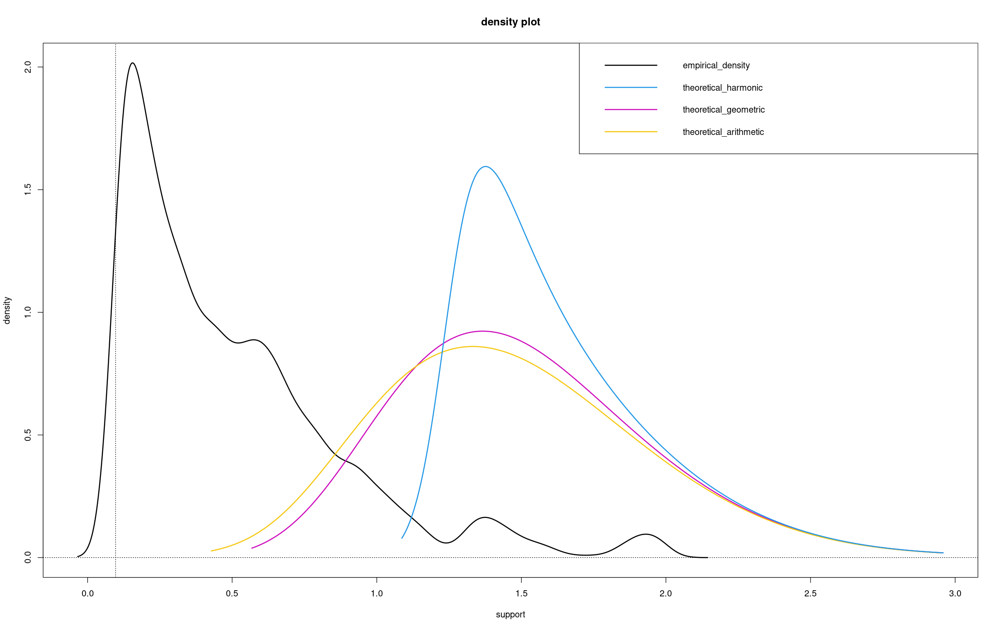

In [134]:
options(repr.plot.width=19, repr.plot.height=12)

plot_fit_non_stationary_gev_mixture_model(ns_gev_mixture_model_object,
                                          data_index = 0,
                                          model_index = 0,
                                          zoom_thresholds = c(-Inf, +Inf),
                                          iterations = 10,
                                          xlab = "support",
                                          ylab = "density",
                                          main = "density plot",
                                          legend_position = "topright")

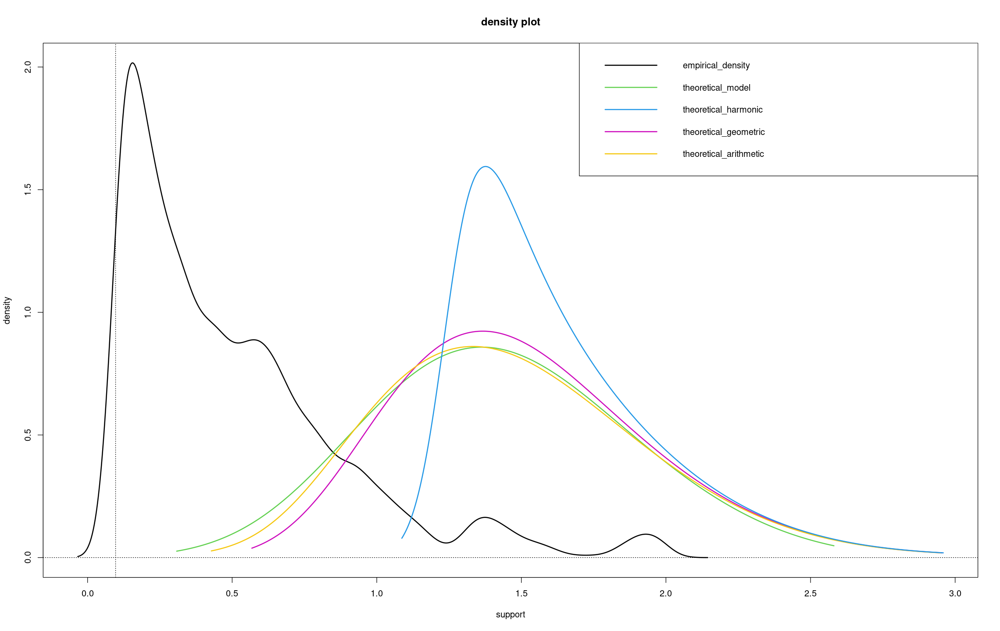

In [135]:
options(repr.plot.width=19, repr.plot.height=12)

plot_fit_non_stationary_gev_mixture_model(ns_gev_mixture_model_object,
                                          data_index = 0,
                                          model_index = which.max(ns_gev_mixture_model_object$weights),
                                          zoom_thresholds = c(-Inf, +Inf),
                                          iterations = 10,
                                          xlab = "support",
                                          ylab = "density",
                                          main = "density plot",
                                          legend_position = "topright")

##  Prediction